# Kenya Agricultural Productivity Prediction at the County Level Using Demographic and Environmental Information
*Author: Mike Gikundi*  

# Abstract

This study develops a predictive model for maize yield in Kenya using socio-economic and land-use variables, combined with statistical regression and machine learning techniques. The model analysis shows moderate prediction performances, subject to errors partly due to multicollinearity in per-capita characteristics. For improvement in accuracy and interpretability, feature selection and cleaning of data were carried out, and geospatial visualization was performed to assess spatial distribution of maize production. A choropleth and heatmap of Kenyan counties reveal regions of high maize output, highlighting spatial disparities in agricultural productivity. The findings demonstrate the potential of integrating predictive modeling with GIS-based visualization to support agricultural planning and policy-making.

# Introduction
This notebook predicts **maize yield per hectare** across Kenyan counties using historical production, land, and population data.
The data used in this project were obtained from trusted national sources. County-level maize production data for the years 2012–2020 were sourced from the Kenya National Bureau of Statistics (KNBS) / National Information Platform for Food and Nutrition (NIPFN) :https://nipfn.knbs.or.ke/download/maize-production-by-county-2012-2020/
. Population and demographic data were drawn from the 2019 Kenya Population and Housing Census, also published by KNBS https://www.knbs.or.ke/census/
. These datasets were combined and enriched with derived indicators such as yield per capita, population density, and log-transformed variables to improve model performance and interpretability.  

**Objectives:**
- Clean and preprocess maize production and population datasets.  
- Engineer features such as per-capita, log-transformed, and anomaly-based targets.  
- Train predictive models and evaluate their performance.  
- Visualize trends and provide insights for agriculture planning.  

In [43]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, KFold, cross_val_score
from sklearn.linear_model import LinearRegression, RidgeCV, LassoCV
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
import joblib
import statsmodels.api as sm
import seaborn as sns

In [2]:
%%capture
%pip install osmnx

In [3]:

import sys, os

!rm -rf fynesse_mlfc
!git clone https://github.com/miketech-traces/fynesse_mlfc.git

repo_path = os.path.abspath("fynesse_mlfc")
if repo_path not in sys.path:
    sys.path.append(repo_path)

print("✅ Repo reloaded and functions ready to use")


Cloning into 'fynesse_mlfc'...
remote: Enumerating objects: 452, done.
remote: Counting objects: 100% (92/92), done.
remote: Compressing objects: 100% (69/69), done.
remote: Total 452 (delta 67), reused 23 (delta 23), pack-reused 360 (from 4)
Receiving objects: 100% (452/452), 13.60 MiB | 20.90 MiB/s, done.
Resolving deltas: 100% (241/241), done.
✅ Repo reloaded and functions ready to use


## 1. Data Access
We start by loading maize production and population datasets.


In [4]:
#maize_df = pd.read_excel('Maize-Production-2012-2020-Combined.xlsx')
maize_df = pd.read_excel('Maize-Production-2012-2020-Combined.xlsx', skiprows=1, header=[0, 1])
population_df = pd.read_csv('2019-population_census-report-per-county.csv')
agricultural_production_df = pd.read_excel('Kenyas_Agricultural_Production.xlsx')

In [77]:
maize_df.head()

Unnamed: 0_level_0                2012                                \
              COUNTY Harvested Area (HA) Production (MT) Yield (MT/HA)   
0            Baringo               39753        71866.62      1.807829   
1              Bomet               32697        73277.82      2.241118   
2            Bungoma               96209       262381.05      2.727199   
3              Busia               41990        50102.37      1.193198   
4    Elgeyo/Marakwet               31533        91964.43      2.916450   

                 2013                                              2014  \
  Harvested Area (HA) Production (MT) Yield (MT/HA) Harvested Area (HA)   
0               29117        55805.04      1.916579               34960   
1               30620        72235.80      2.359105               30940   
2               92705       221586.03      2.390227               98074   
3               45898        63229.50      1.377609               50400   
4               32015       101335.77      3.165259               27620   

                                 ...          2016             2017  \
  Production (MT) Yield (MT/HA)  ... Yield (MT/HA)  Area (HA)  2017   
0         34959.0      0.999971  ...      2.186021            33308   
1         53162.0      1.718229  ...      1.410287            33792   
2        267302.0      2.725513  ...      2.989396            95323   
3         72662.0      1.441706  ...      0.952915            31962   
4        103448.0      3.745402  ...      2.251388            28373   

                                              2018                    \
   Production (MT)  2017 Yield(MT/HA) Area Ha 2018 Quantity Ton 2018   
0                45764.0     1.373964      37658.0         58475.600   
1                56601.0     1.674982      33291.0         58336.810   
2               289290.0     3.034839      93484.0        295481.100   
3                51483.0     1.610757      33122.0         53629.000   
4                80823.0     2.848588      30631.0         92601.412   

                         2020                                     
  Yield(MT/HA) Area (Ha) 2020 Production (MT) 2020 Yield (MT/HA)  
0     1.552807        47437.0             68374.39      1.441373  
1     1.752330        38163.0             73609.65      1.928822  
2     3.160767        87960.0            317912.33      3.614283  
3     1.619135        48150.0             69449.50      1.442357  
4     3.023127        25856.0             87431.25      3.381469  

[5 rows x 25 columns]

In [39]:
population_df.head()

,County,Total_Population19,Male populatio 2019,Female population 2019,Households,Av_HH_Size,LandArea,Population Density,Population in 2009,Pop_change,Intersex population 2019
0,Baringo,"666,763","336,322","330,428","142,518",5,"10,976",61,"555,561","111,202",13
1,Bomet,"875,689","434,287","441,379","187,641",5,"2,531",346,"724,186","151,503",23
2,Bungoma,"1,670,570","812,146","858,389","358,796",5,"3,024",552,"1,630,934","39,636",35
3,Busia,"893,681","426,252","467,401","198,152",5,"1,696",527,"488,075","405,606",28
4,Elgeyo-Marakwet,"454,480","227,317","227,151","99,861",5,"3,032",150,"369,998","84,482",12


In [40]:
population_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 47 entries, 0 to 46
Data columns (total 11 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   County                    47 non-null     object
 1   Total_Population19        47 non-null     object
 2   Male populatio 2019       47 non-null     object
 3   Female population 2019    47 non-null     object
 4   Households                47 non-null     object
 5   Av_HH_Size                47 non-null     int64 
 6   LandArea                  47 non-null     object
 7   Population Density        47 non-null     object
 8   Population in 2009        47 non-null     object
 9   Pop_change                47 non-null     object
 10  Intersex population 2019  47 non-null     int64 
dtypes: int64(2), object(9)
memory usage: 4.2+ KB


In [41]:
population_df.describe()

,Av_HH_Size,Intersex population 2019
count,47.000000,47.000000
mean,4.340426,32.425532
std,0.938931,38.490961
min,3.000000,2.000000
25%,4.000000,18.000000
50%,4.000000,25.000000
75%,5.000000,34.000000
max,7.000000,245.000000


In [42]:
maize_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49 entries, 0 to 48
Data columns (total 25 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Unnamed: 0   48 non-null     object
 1   Unnamed: 1   49 non-null     object
 2   Unnamed: 2   48 non-null     object
 3   Unnamed: 3   48 non-null     object
 4   Unnamed: 4   49 non-null     object
 5   Unnamed: 5   48 non-null     object
 6   Unnamed: 6   48 non-null     object
 7   Unnamed: 7   49 non-null     object
 8   Unnamed: 8   48 non-null     object
 9   Unnamed: 9   48 non-null     object
 10  Unnamed: 10  49 non-null     object
 11  Unnamed: 11  48 non-null     object
 12  Unnamed: 12  48 non-null     object
 13  Unnamed: 13  49 non-null     object
 14  Unnamed: 14  48 non-null     object
 15  Unnamed: 15  48 non-null     object
 16  Unnamed: 16  49 non-null     object
 17  Unnamed: 17  48 non-null     object
 18  Unnamed: 18  48 non-null     object
 19  Unnamed: 19  49 non-null     ob

In [43]:
maize_df.describe()

,Unnamed: 0,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,...,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24
count,48,49,48,48,49,48,48,49,48,48,...,48,49,48,48,49,48,48,49,48,48
unique,48,49,48,48,48,48,48,46,48,48,...,48,49,48,48,49,48,48,49,48,48
top,COUNTY,2012,Production (MT),Yield (MT/HA),61416,Production (MT),Yield (MT/HA),653,Production (MT),Yield (MT/HA),...,Yield (MT/HA),2017,Production (MT) 2017,Yield(MT/HA),2018,Quantity Ton 2018,Yield(MT/HA),2020,Production (MT) 2020,Yield (MT/HA)
freq,1,1,1,1,2,1,1,3,1,1,...,1,1,1,1,1,1,1,1,1,1


## 2. Data Cleaning & Merging
We clean numeric fields, handle missing values, and merge the datasets by county.


In [48]:
import sys
import os


repo_path = '/content/fynesse_mlfc'


if os.path.isdir(repo_path):
    sys.path.insert(0, repo_path)
    print(f"Added {repo_path} to the system path.")
else:
    print(f"Error: Repository not found at {repo_path}. Please check the path.")

from fynesse.access import load_maize_data, load_population_data

maize_df = load_maize_data('Maize-Production-2012-2020-Combined.xlsx')
population_df = load_population_data('2019-population_census-report-per-county.csv')

print("Maize Data Loaded:")
print(maize_df.head(10))
print("\nPopulation Data Loaded:")
print(population_df.head(10))

Added /content/fynesse_mlfc to the system path.
Maize Data Loaded:
    County  Year  Harvested_Area_Ha  Production_Tons  Yield_t_per_ha
0  Baringo  2012           71866.62         1.807829         29117.0
1  Baringo  2013           55805.04         1.916579         34960.0
2  Baringo  2014           34959.00         0.999971         44159.0
3  Baringo  2015           83313.00         1.886660         33163.0
4  Baringo  2016           72495.00         2.186021         33308.0
5  Baringo  2017           45764.00         1.373964         37658.0
6  Baringo  2018           58475.60         1.552807         47437.0
7    Bomet  2012           73277.82         2.241118         30620.0
8    Bomet  2013           72235.80         2.359105         30940.0
9    Bomet  2014           53162.00         1.718229         35727.0

Population Data Loaded:
            County  Total_Population19  Male populatio 2019  \
0          Baringo              666763               336322   
1            Bomet     

In [49]:
# Display columns before merging to verify names
print("Columns in maize_df:", maize_df.columns)
print("Columns in population_df:", population_df.columns)

Columns in maize_df: Index(['County', 'Year', 'Harvested_Area_Ha', 'Production_Tons',
       'Yield_t_per_ha'],
      dtype='object')
Columns in population_df: Index(['County', 'Total_Population19', 'Male populatio 2019',
       'Female population 2019', 'Households', 'Av_HH_Size', 'LandArea',
       'Population Density', 'Population in 2009', 'Pop_change',
       'Intersex population 2019', 'Year'],
      dtype='object')


In [50]:
print("Columns in maize_df:", maize_df.columns)

Columns in maize_df: Index(['County', 'Year', 'Harvested_Area_Ha', 'Production_Tons',
       'Yield_t_per_ha'],
      dtype='object')


In [51]:
# Clean maize data
def clean_maize_data(maize_df):
    """Clean maize production data"""
    # Convert to appropriate data types
    maize_df['Harvested_Area_Ha'] = pd.to_numeric(maize_df['Harvested_Area_Ha'], errors='coerce')
    maize_df['Production_Tons'] = pd.to_numeric(maize_df['Production_Tons'], errors='coerce')
    maize_df['Yield_t_per_ha'] = pd.to_numeric(maize_df['Yield_t_per_ha'], errors='coerce')

    # Remove rows with missing critical values
    maize_df = maize_df.dropna(subset=['Yield_t_per_ha', 'Harvested_Area_Ha', 'Production_Tons'])

    return maize_df

maize_df_clean = clean_maize_data(maize_df)




In [52]:
from fynesse.assess import merge_datasets

In [53]:

df_final = merge_datasets(maize_df_clean, population_df)

In [54]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
Index: 294 entries, 0 to 328
Data columns (total 12 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   County                     294 non-null    object 
 1   Year                       294 non-null    int64  
 2   Harvested_Area_Ha          294 non-null    float64
 3   Production_Tons            294 non-null    float64
 4   Yield_t_per_ha             294 non-null    float64
 5   Total_Population19         294 non-null    float64
 6   LandArea                   294 non-null    float64
 7   Population Density         294 non-null    float64
 8   Yield_per_capita           294 non-null    float64
 9   Harvested_Area_per_capita  294 non-null    float64
 10  Production_per_capita      294 non-null    float64
 11  Area_per_land              294 non-null    float64
dtypes: float64(10), int64(1), object(1)
memory usage: 29.9+ KB


In [55]:
display(df_final.isnull().sum())

,0
County,0
Year,0
Harvested_Area_Ha,0
Production_Tons,0
Yield_t_per_ha,0
Total_Population19,0
LandArea,0
Population Density,0
Yield_per_capita,0
Harvested_Area_per_capita,0


In [56]:
print("Columns in maize_df before feature engineering:", maize_df.columns)

Columns in maize_df before feature engineering: Index(['County', 'Year', 'Harvested_Area_Ha', 'Production_Tons',
       'Yield_t_per_ha'],
      dtype='object')


In [57]:
# Drop columns with > 80% missing (adjust threshold if you like)
thresh = int(0.2 * len(df_final))
df_final = df_final.dropna(axis=1, thresh=thresh)


## 3. Feature Engineering  
We derive new features such as:  
- Log-transformed values (to handle skewness).  
- Yield anomalies and z-scores.  
- Year-over-year growth.  
- Binary low-yield indicators.  


In [58]:
from fynesse.assess import add_log_features

In [59]:

df_final = add_log_features(df_final)
df_final['log_Yield_t_per_ha'] = np.log1p(df_final['Yield_t_per_ha'])

features = [
    'Harvested_Area_Ha',
    'Production_Tons',
    'Total_Population19',
    'LandArea',
    'Population Density',
    'Yield_per_capita',
    'Harvested_Area_per_capita',
    'Area_per_land',
    'log_Harvested_Area_Ha',
    'log_Production_Tons',
    'log_Total_Population19',
    'log_LandArea'
]

X = df_final[features]
y = df_final['Yield_t_per_ha']


In [60]:

df_final = df_final[df_final['Yield_t_per_ha'] > 0]
# Removed redundant filtering by year here
print("Columns in maize_df after feature engineering:", maize_df.columns)

Columns in maize_df after feature engineering: Index(['County', 'Year', 'Harvested_Area_Ha', 'Production_Tons',
       'Yield_t_per_ha'],
      dtype='object')


In [61]:
# Remove highly correlated features
from sklearn.linear_model import Ridge
model = Ridge(alpha=1.0)

In [62]:
# Primary target: Yield per hectare (base target)
df_final['target_yield_t_per_ha'] = df_final['Yield_t_per_ha']
df_final['log_Yield_t_per_ha'] = np.log1p(df_final['Yield_t_per_ha'])

# Log-transformed yield (stabilizes variance, reduces skew)
df_final['target_log_yield'] = np.log1p(df_final['Yield_t_per_ha'])

#  Total production (tonnes) = yield * harvested area
df_final['target_total_production'] = df_final['Yield_t_per_ha'] * df_final['Harvested_Area_Ha']

#  Log total production (for skew handling)
df_final['target_log_production'] = np.log1p(df_final['target_total_production'])

# Yield anomaly = yield - county average yield
df_final['target_yield_anomaly'] = (
    df_final['Yield_t_per_ha'] -
    df_final.groupby('County')['Yield_t_per_ha'].transform('mean')
)

# 6. Yield z-score (normalized anomaly)
df_final['target_yield_zscore'] = (
    df_final['target_yield_anomaly'] /
    df_final.groupby('County')['Yield_t_per_ha'].transform('std')
)

# Year-over-year growth in yield (% change from previous year, per county)
df_final = df_final.sort_values(by=['County','Year'])
df_final['target_yield_growth'] = df_final.groupby('County')['Yield_t_per_ha'].pct_change()

# Binary low-yield flag (e.g., yield below 25th percentile across dataset)
low_threshold = df_final['Yield_t_per_ha'].quantile(0.25)
df_final['target_low_yield_flag'] = (df_final['Yield_t_per_ha'] < low_threshold).astype(int)

print(df_final[['County','Year','Yield_t_per_ha',
                'target_yield_t_per_ha','target_log_yield',
                'target_total_production','target_log_production',
                'target_yield_anomaly','target_yield_zscore',
                'target_yield_growth','target_low_yield_flag']].head(15))

     County  Year  Yield_t_per_ha  target_yield_t_per_ha  target_log_yield  \
0   Baringo  2012         29117.0                29117.0         10.279112   
1   Baringo  2013         34960.0                34960.0         10.461988   
2   Baringo  2014         44159.0                44159.0         10.695575   
3   Baringo  2015         33163.0                33163.0         10.409220   
4   Baringo  2016         33308.0                33308.0         10.413583   
5   Baringo  2017         37658.0                37658.0         10.536327   
6   Baringo  2018         47437.0                47437.0         10.767179   
7     Bomet  2012         30620.0                30620.0         10.329441   
8     Bomet  2013         30940.0                30940.0         10.339837   
9     Bomet  2014         35727.0                35727.0         10.483690   
10    Bomet  2015         32275.0                32275.0         10.382079   
11    Bomet  2016         33792.0                33792.0        

Primary target + log yield


In [63]:
df_final['target_yield_t_per_ha'] = df_final['Yield_t_per_ha']
df_final['target_log_yield'] = np.log1p(df_final['Yield_t_per_ha'])

In [64]:
df_final['target_total_production'] = (
    df_final['Yield_t_per_ha'] * df_final['Harvested_Area_Ha']
)
df_final['target_log_production'] = np.log1p(df_final['target_total_production'])

In [65]:
# Yield anomaly
county_mean = df_final.groupby('County')['Yield_t_per_ha'].transform('mean')
county_std = df_final.groupby('County')['Yield_t_per_ha'].transform('std')

df_final['target_yield_anomaly'] = df_final['Yield_t_per_ha'] - county_mean
df_final['target_yield_zscore'] = df_final['target_yield_anomaly'] / county_std

In [66]:
# Yield growth (YoY % change per county)
df_final = df_final.sort_values(by=['County', 'Year'])
df_final['target_yield_growth'] = (
    df_final.groupby('County')['Yield_t_per_ha'].pct_change()
)

In [67]:
low_threshold = df_final['Yield_t_per_ha'].quantile(0.25)
df_final['target_low_yield_flag'] = (
    df_final['Yield_t_per_ha'] < low_threshold
).astype(int)

Results inspection

In [68]:
print(df_final[['County','Year','Yield_t_per_ha',
                'target_yield_t_per_ha','target_log_yield',
                'target_total_production','target_log_production',
                'target_yield_anomaly','target_yield_zscore',
                'target_yield_growth','target_low_yield_flag']].head(15))

     County  Year  Yield_t_per_ha  target_yield_t_per_ha  target_log_yield  \
0   Baringo  2012         29117.0                29117.0         10.279112   
1   Baringo  2013         34960.0                34960.0         10.461988   
2   Baringo  2014         44159.0                44159.0         10.695575   
3   Baringo  2015         33163.0                33163.0         10.409220   
4   Baringo  2016         33308.0                33308.0         10.413583   
5   Baringo  2017         37658.0                37658.0         10.536327   
6   Baringo  2018         47437.0                47437.0         10.767179   
7     Bomet  2012         30620.0                30620.0         10.329441   
8     Bomet  2013         30940.0                30940.0         10.339837   
9     Bomet  2014         35727.0                35727.0         10.483690   
10    Bomet  2015         32275.0                32275.0         10.382079   
11    Bomet  2016         33792.0                33792.0        

In [69]:
feature_cols = [
    'Harvested_Area_Ha',
    'Total_Population19',
    'LandArea',
    'Population Density',
    'Harvested_Area_per_capita',

]

target_choice = 'log_Yield_t_per_ha'

In [70]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
Index: 293 entries, 0 to 328
Data columns (total 25 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   County                     293 non-null    object 
 1   Year                       293 non-null    int64  
 2   Harvested_Area_Ha          293 non-null    float64
 3   Production_Tons            293 non-null    float64
 4   Yield_t_per_ha             293 non-null    float64
 5   Total_Population19         293 non-null    float64
 6   LandArea                   293 non-null    float64
 7   Population Density         293 non-null    float64
 8   Yield_per_capita           293 non-null    float64
 9   Harvested_Area_per_capita  293 non-null    float64
 10  Production_per_capita      293 non-null    float64
 11  Area_per_land              293 non-null    float64
 12  log_Harvested_Area_Ha      293 non-null    float64
 13  log_Production_Tons        293 non-null    float64
 14 

In [71]:
df_final.head()

,County,Year,Harvested_Area_Ha,Production_Tons,Yield_t_per_ha,Total_Population19,LandArea,Population Density,Yield_per_capita,Harvested_Area_per_capita,...,log_LandArea,log_Yield_t_per_ha,target_yield_t_per_ha,target_log_yield,target_total_production,target_log_production,target_yield_anomaly,target_yield_zscore,target_yield_growth,target_low_yield_flag
0,Baringo,2012,71866.62,1.807829,29117.0,666763.0,10976.0,61.0,0.000003,0.107784,...,9.303557,10.279112,29117.0,10.279112,2.092540e+09,21.461645,-7997.571429,-1.226339,NaN,0
1,Baringo,2013,55805.04,1.916579,34960.0,666763.0,10976.0,61.0,0.000003,0.083695,...,9.303557,10.461988,34960.0,10.461988,1.950944e+09,21.391579,-2154.571429,-0.330380,0.200673,0
2,Baringo,2014,34959.00,0.999971,44159.0,666763.0,10976.0,61.0,0.000001,0.052431,...,9.303557,10.695575,44159.0,10.695575,1.543754e+09,21.157483,7044.428571,1.080185,0.263129,0
3,Baringo,2015,83313.00,1.886660,33163.0,666763.0,10976.0,61.0,0.000003,0.124951,...,9.303557,10.409220,33163.0,10.409220,2.762909e+09,21.739550,-3951.571429,-0.605930,-0.249009,0
4,Baringo,2016,72495.00,2.186021,33308.0,666763.0,10976.0,61.0,0.000003,0.108727,...,9.303557,10.413583,33308.0,10.413583,2.414663e+09,21.604826,-3806.571429,-0.583695,0.004372,0


## 4. Exploratory Data Analysis (EDA)  
We visualize yield distributions, production trends

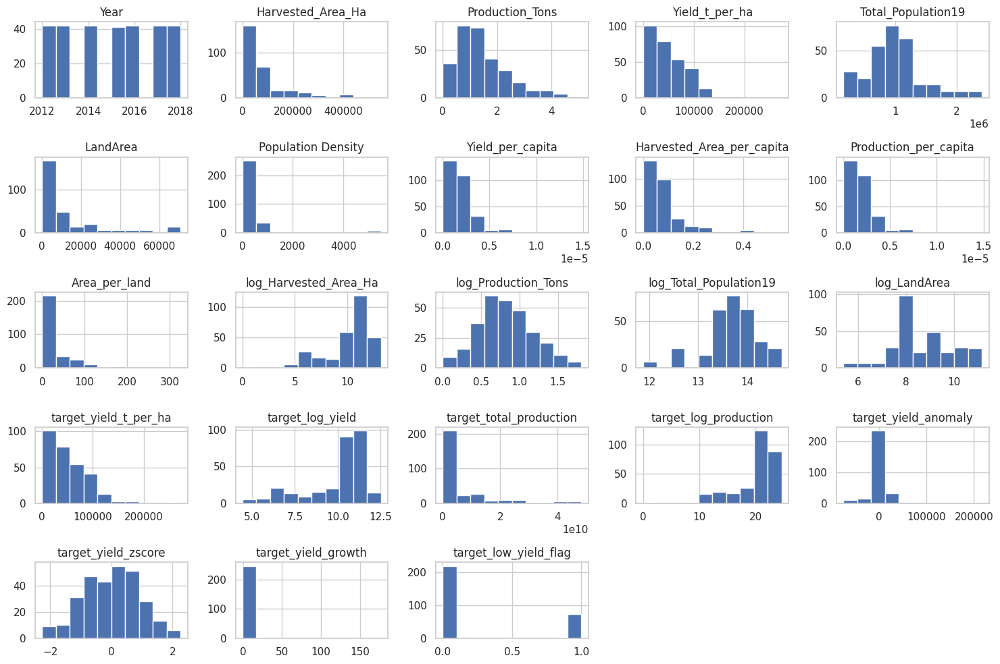

In [ ]:
# Visualization of the distributions of numerical features
df_final.hist(figsize=(15, 10))
plt.tight_layout()
plt.show()

The histograms show how distributions rise sharply, clustered tightly around common values, while others stretch long tails that hint at the few counties with vast land or unusually high yields.

For yield per hectare, the bars reveal that most regions sit within a moderate range, though a handful of outliers push production higher. Harvested area and total population show a very different picture, with wide spreads and skewed patterns that reflect Kenya’s uneven geography and population distribution. Land area varies even more dramatically, where small counties coexist alongside massive territories, shaping how agriculture is practiced.

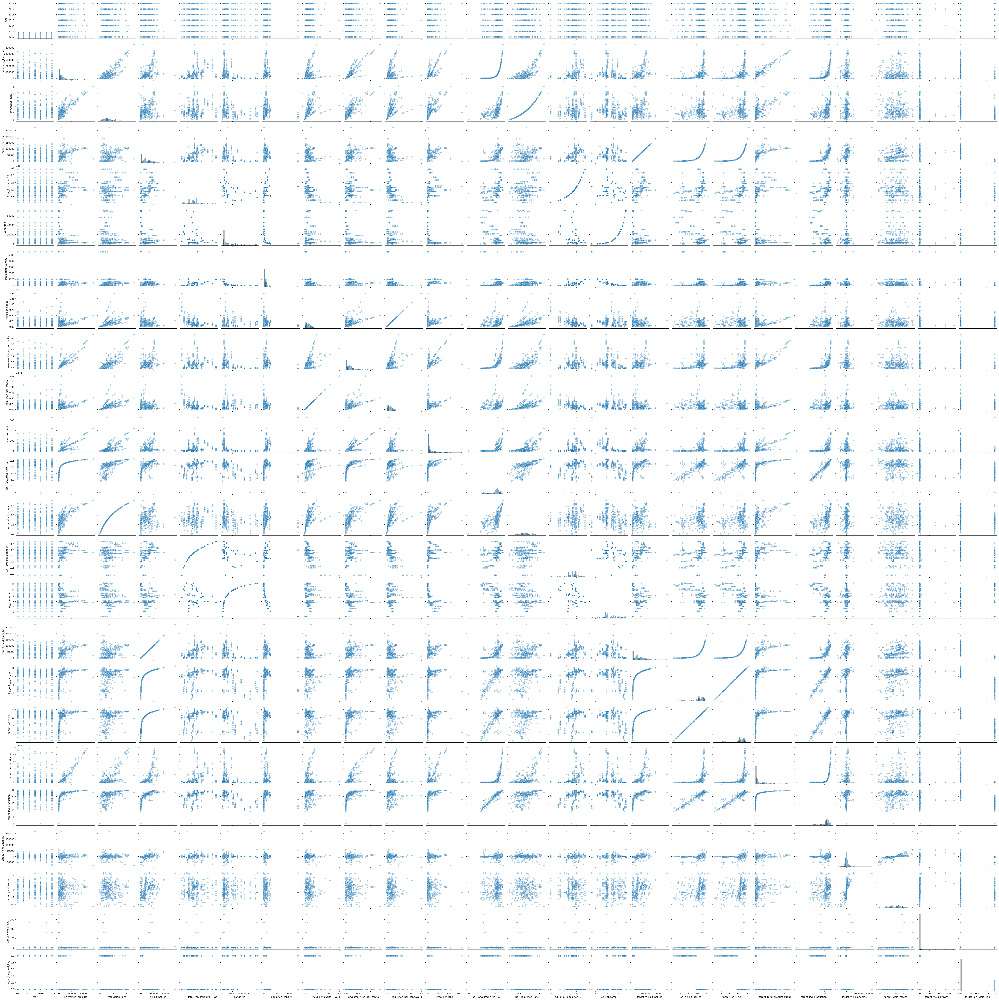

In [ ]:
sns.pairplot(df_final,
             kind='scatter',
             plot_kws={'alpha':0.4},
             diag_kws={'alpha':0.55, 'bins':40})

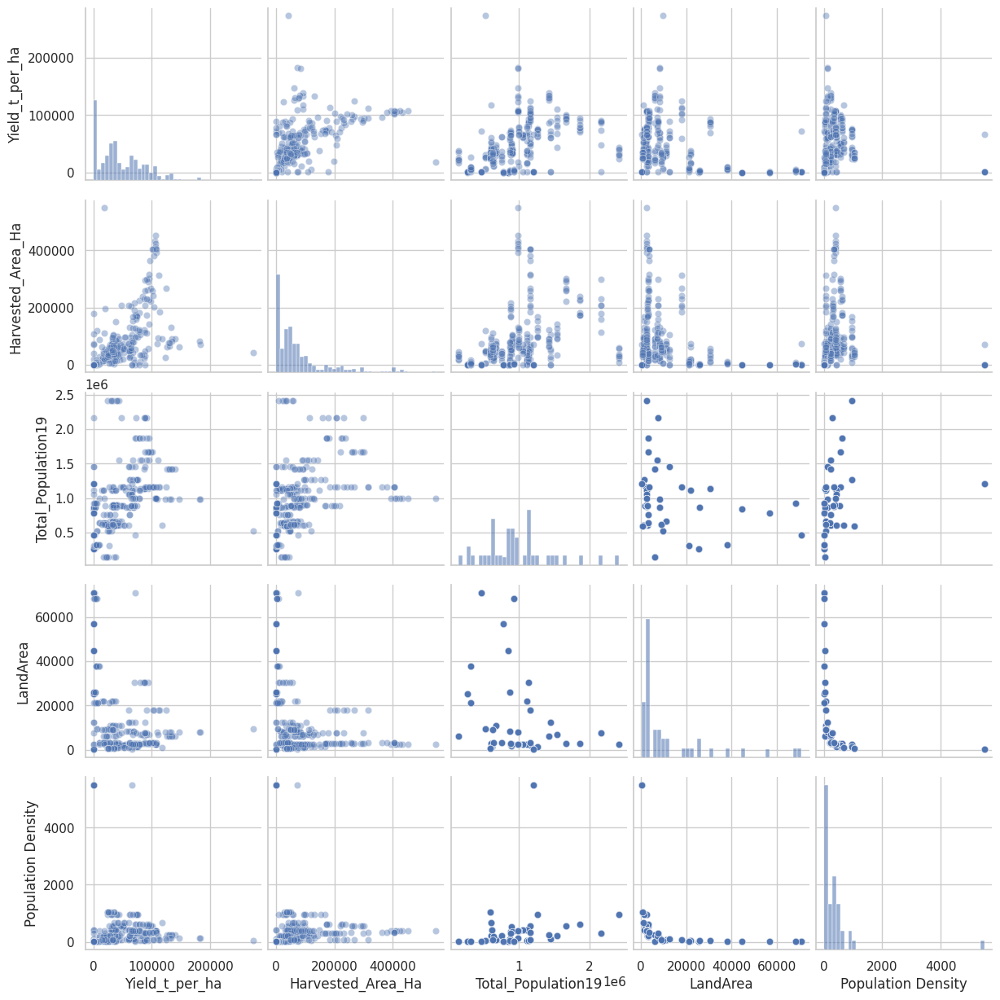

In [ ]:

columns_to_plot = ['Yield_t_per_ha', 'Harvested_Area_Ha', 'Total_Population19', 'LandArea', 'Population Density']

sns.pairplot(df_final[columns_to_plot],
             kind='scatter',
             plot_kws={'alpha':0.4},
             diag_kws={'alpha':0.55, 'bins':40})
plt.show()

The scatterplot matrix reveals the connections between Kenya's maize yield and the factors that influence it. Each diagonal panel displays the distribution of a single variable, from harvested area to population density. This shows where the data groups together and where it spreads out.

When looking at the scatterplots, some relationships are clearer than others. Yield per hectare varies greatly with population and land area, indicating that maize productivity is not just about size or numbers. The harvested area shows a more direct link; larger cultivated lands often lead to higher yields. However, the cloud of points reminds us that efficiency differs across locations.

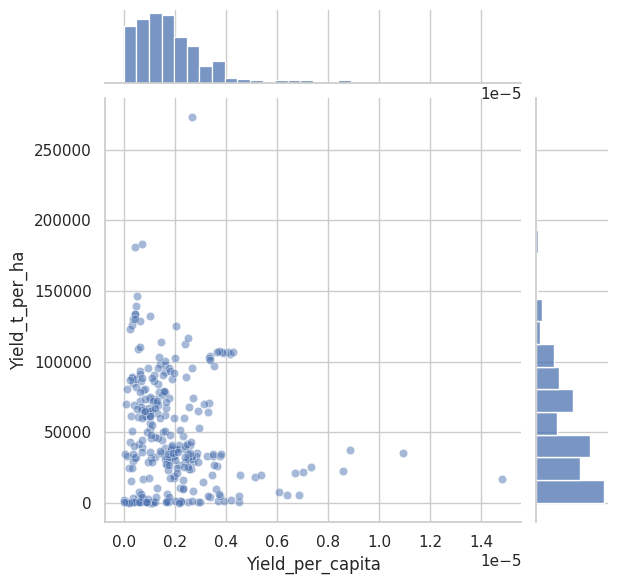

In [ ]:
sns.jointplot(x='Yield_per_capita', y='Yield_t_per_ha', data=df_final, alpha=0.5)

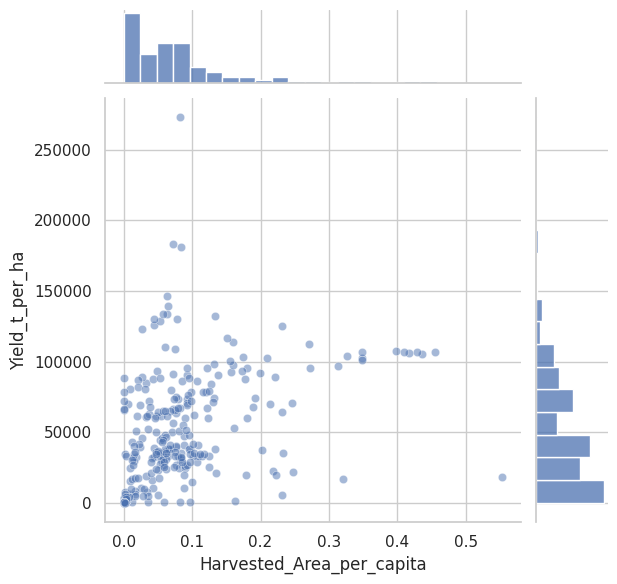

In [ ]:
# Scatter plot: Yield vs Harvested Area per capita
sns.jointplot(x='Harvested_Area_per_capita', y='Yield_t_per_ha', data=df_final, alpha=0.5)

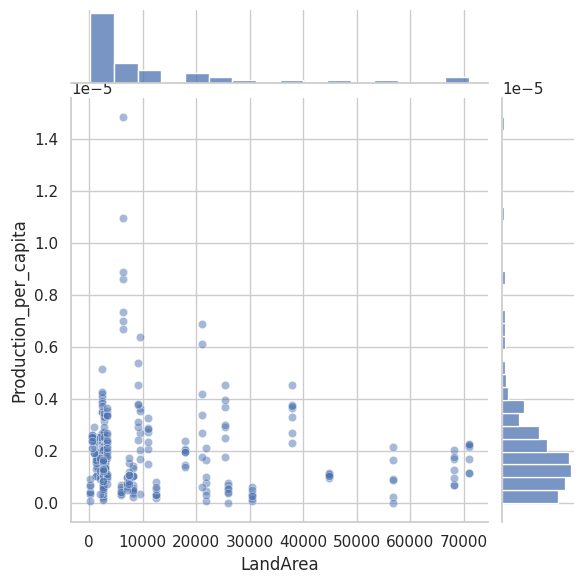

In [ ]:
sns.jointplot(x='LandArea', y='Production_per_capita', data=df_final, alpha=0.5)

We see here a scatter of points, where the x-axis measures the vastness of a county's land area, and the y-axis tells us about the agricultural bounty it provides per person.

## Correlation Matrix  

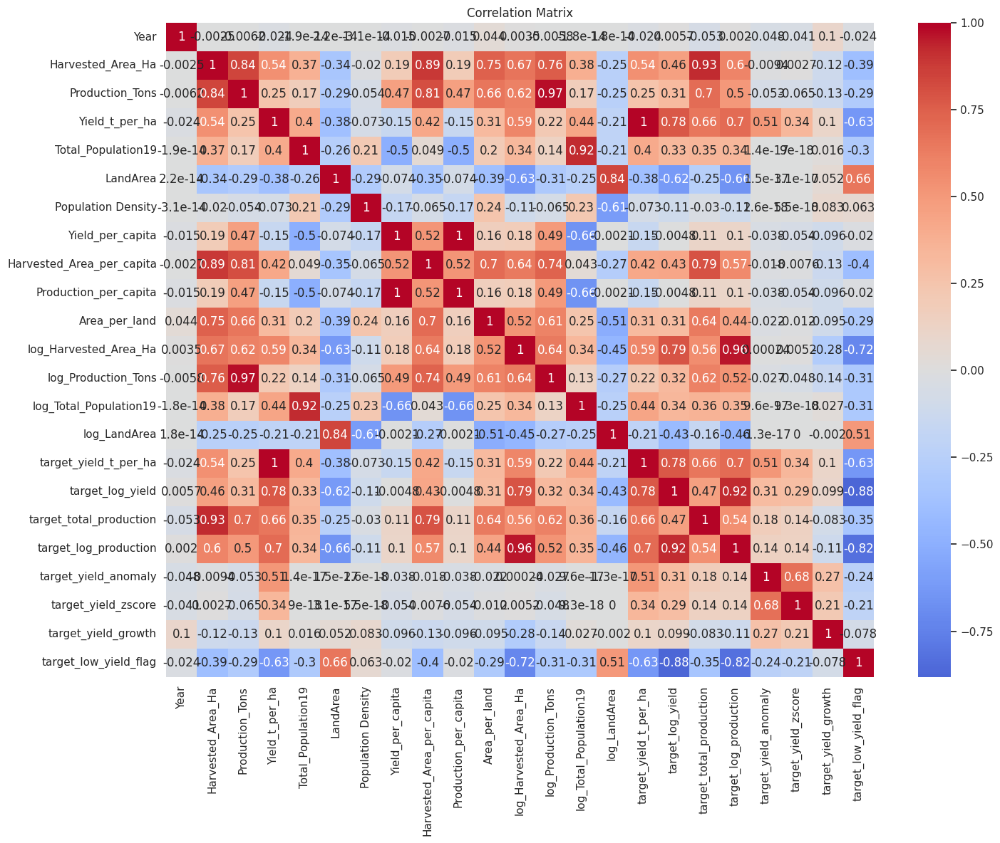

In [ ]:
    # Correlation matrix
    numeric_cols = df_final.select_dtypes(include=[np.number]).columns
    corr_matrix = df_final[numeric_cols].corr()

    plt.figure(figsize=(15, 12))
    sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', center=0)
    plt.title('Correlation Matrix')
    plt.tight_layout()
    plt.show()

To understand how different features relate to each other and to the target variable (Yield per hectare),  
we compute a **correlation matrix**.  

- Positive correlation → as one variable increases, the other also increases.  
- Negative correlation → as one variable increases, the other decreases.  
- Values close to **+1** or **-1** indicate strong relationships.  
- Values near **0** indicate weak or no correlation.  

This analysis helps identify which features are most informative for predicting yield.

### Key Findings from Our Data
1. Strong Multicollinearity: We observe a very strong positive correlation (approximately 0.94) between Harvested_Area_Ha and Production_Tons. This is known as multicollinearity
2. Moderate Negative Correlation with Yield: There is a notable moderate negative correlation (around -0.52) between our target variable, Yield_t_per_ha, and Production_Tons. This suggest that increases in total production are more strongly linked to increases in the harvested area rather than improvements in yield per hectare.
3. Positive Relationships with Yield: Our target variable, Yield_t_per_ha, shows positive correlations with other features, such as Population Density and our newly engineered features like Yield_per_capita and Area_per_land.

## Spatial distribution across Kenya using a heatmap

In [25]:
import sys
import os

In [26]:
from fynesse.access import load_maize_production

In [27]:
maize_production_df = load_maize_production("Maize-Production-2012-2020-Combined.xlsx")

In [28]:
from fynesse.access import load_maize_production

In [29]:
import importlib
import fynesse.assess as assess
importlib.reload(assess)

from fynesse.assess import restructure_maize_data

In [30]:
maize_production_df = load_maize_production("Maize-Production-2012-2020-Combined.xlsx")
maize_yield = restructure_maize_data(maize_production_df)

In [31]:
!pip install matplotlib-scalebar

In [33]:
import matplotlib.pyplot as plt
from fynesse.address import plot_maize_yield_map


In [40]:
import geopandas as gpd

def kenya_map(geojson_url=None):
    """
    Load the Kenya counties GeoJSON as a GeoDataFrame.
    """
    if geojson_url is None:
        geojson_url = (
            "https://open.africa/dataset/a8f8b195-aafd-449b-9b1a-ab337fd9925f/"
            "resource/4fb2e27e-c001-4b7f-b71d-4fee4a96a0f8/"
            "download/kenyan-counties.geojson"
        )

    kenya_map = gpd.read_file(geojson_url)

    if "COUNTY" in kenya_map.columns:
        kenya_map["County"] = kenya_map["COUNTY"].str.strip().str.title()

    return kenya_map

In [48]:
import importlib
import fynesse.address
importlib.reload(fynesse.address)

from fynesse.address import plot_avg_yield_map

In [49]:
import geopandas as gpd
import pandas as pd

# --- 1. Compute average maize yield ---
# maize_yield should be your DataFrame with columns ["County", "Year", "Yield (MT/HA)"]
avg_yield = maize_yield.groupby("County", as_index=False)["Yield (MT/HA)"].mean()

# --- 2. Load Kenya counties GeoJSON ---
geojson_url = "https://open.africa/dataset/a8f8b195-aafd-449b-9b1a-ab337fd9925f/resource/4fb2e27e-c001-4b7f-b71d-4fee4a96a0f8/download/kenyan-counties.geojson"
kenya_map = gpd.read_file(geojson_url)

# Standardize names in both
kenya_map["County"] = kenya_map["COUNTY"].str.strip().str.title()
avg_yield["County"] = avg_yield["County"].str.strip().str.title()

# --- 3. Merge ---
merged = kenya_map.merge(avg_yield, on="County", how="left")


/usr/local/lib/python3.12/dist-packages/matplotlib_scalebar/scalebar.py:457: UserWarning: Drawing scalebar on axes with unequal aspect ratio; either call ax.set_aspect(1) or suppress the warning with rotation='horizontal-only'.
  warnings.warn(


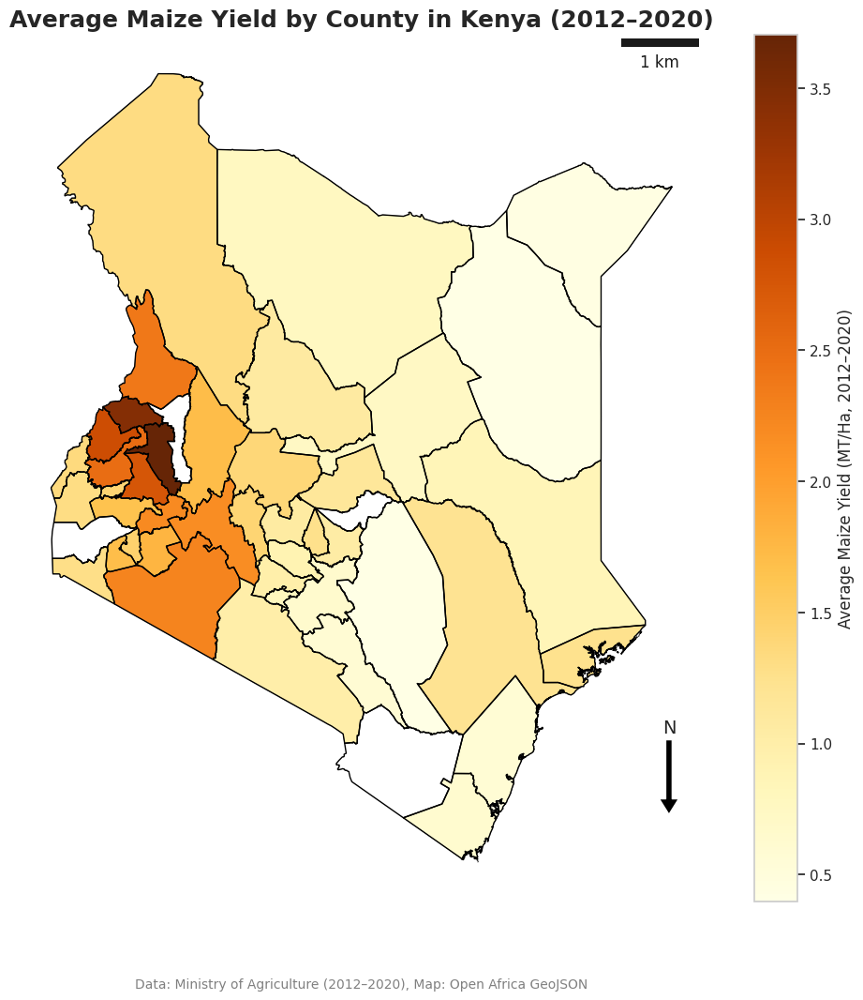

In [50]:
#merged = kenya_map.merge(avg_yield, on="County", how="left")
plot_avg_yield_map(kenya_map, avg_yield)


In [51]:
import importlib
import fynesse.address
importlib.reload(fynesse.address)

from fynesse.address import plot_interactive_yield_map

# Generate and display the map
m = plot_interactive_yield_map(merged)
m  # Displays inside Jupyter Notebook

The map displays county-level averages of maize yield across Kenya, highlighting distinct regional patterns. Counties in agriculturally favorable zones appear in darker shades, indicating higher yields, while lighter areas point to relatively lower productivity. This variation reflects the combined influence of rainfall distribution, soil fertility, land availability, and population pressure on cultivated land. The concentration of high-yield areas in certain regions underlines their role as key contributors to national food security, while the lower-yield zones suggest constraints that may require policy attention, such as improved access to inputs, irrigation, or climate adaptation strategies. The map thus provides a spatial lens to understand agricultural disparities and potential opportunities for resource allocation and development planning.

# 5. Splitting the data


To evaluate model performance reliably, we split the dataset into **training** and **testing** subsets:  

- **Training set (70%)** → used to fit the model and learn relationships between features and the target.  
- **Testing set (30%)** → kept aside and only used to evaluate the model’s performance on unseen data.  

This prevents overfitting, where the model memorizes the training data but performs poorly on new data.  

We use `random_state=42` to ensure reproducibility — the split will be the same every time the notebook is run.  


In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:

X = df_final[feature_cols]
y = df_final[target_choice]

In [ ]:
X.head()
y.head()

,log_Yield_t_per_ha
0,10.279112
1,10.461988
2,10.695575
3,10.409220
4,10.413583


In [ ]:
# Split the data
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=42
)


In [ ]:
# Display the shapes of the training and testing sets
print("Shape of X_train:", X_train.shape)
print("Shape of X_test:", X_test.shape)
print("Shape of y_train:", y_train.shape)
print("Shape of y_test:", y_test.shape)

Shape of X_train: (205, 5)
Shape of X_test: (88, 5)
Shape of y_train: (205,)
Shape of y_test: (88,)


# 6. Training the Model with multivariable regression using Scikit Learn





We use a **Linear Regression model** from Scikit-Learn to predict maize yield per hectare.  

- The model fits a linear equation of the form:
$$
  [
  y = \beta_0 + \beta_1 X_1 + \beta_2 X_2 + \dots + \beta_n X_n
  ]
$$
  where \( y \) is the target (yield), and \( X_1, X_2, ..., X_n \) are the feature variables.  

- **Coefficients (`coef_`)** → show how much each feature contributes to the prediction, holding other features constant.  
  - Positive coefficient → feature increases yield.  
  - Negative coefficient → feature decreases yield.  

- **R² score (`score`)** → measures how well the model explains the variance in the data (1.0 = perfect fit, 0 = no explanatory power).  

After training, we examine the coefficients to interpret which factors most influence yield.  


In [ ]:
from sklearn.linear_model import LinearRegression

In [ ]:
lm = LinearRegression()

In [ ]:
# Train the model
lm.fit(X_train, y_train)

LinearRegression()

In [ ]:
# the coefficients
lm.coef_

array([ 2.11481449e-08,  8.37007522e-07, -5.79039043e-05, -5.52043594e-04,
        3.35779848e+00])

In [ ]:
# r squared
lm.score(X, y)

0.5541034012307854

In [ ]:
# The coefficients in a dataframe
cdf = pd.DataFrame(lm.coef_,X.columns,columns=['Coef'])
print(cdf)

                                   Coef
Harvested_Area_Ha          2.114814e-08
Total_Population19         8.370075e-07
LandArea                  -5.790390e-05
Population Density        -5.520436e-04
Harvested_Area_per_capita  3.357798e+00


# 7. Training the model with multivariable regression using OLS



We also train a **Linear Regression model using Ordinary Least Squares (OLS)** from `statsmodels`.  

Unlike Scikit-Learn’s `LinearRegression`, OLS provides detailed statistical diagnostics:  

- **Coefficients** → estimated effect of each feature on the target.  
- **P-values** → indicate whether a feature is statistically significant (commonly, p < 0.05 means significant).  
- **R² and Adjusted R²** → measure explanatory power of the model.  
- **F-statistic** → tests whether the overall regression model is statistically significant.  
- **Confidence Intervals** → show the plausible range for each coefficient.  

This richer output helps assess not just model fit, but also the reliability of each predictor.  


In [ ]:
import statsmodels.api as sm

X = sm.add_constant(X_train)
model = sm.OLS(y_train, X)
model_fit = model.fit()
print(model_fit.summary())

                            OLS Regression Results                            
Dep. Variable:     log_Yield_t_per_ha   R-squared:                       0.550
Model:                            OLS   Adj. R-squared:                  0.539
Method:                 Least Squares   F-statistic:                     48.66
Date:                Mon, 22 Sep 2025   Prob (F-statistic):           9.69e-33
Time:                        04:01:52   Log-Likelihood:                -321.42
No. Observations:                 205   AIC:                             654.8
Df Residuals:                     199   BIC:                             674.8
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
const                 

# Predicting Test Data

In [ ]:
# Train the model and save it to a file
lm.fit(X_train, y_train)
joblib.dump(lm, 'maize_yield_predictor.pkl')
print("Model trained and saved successfully.")

Model trained and saved successfully.


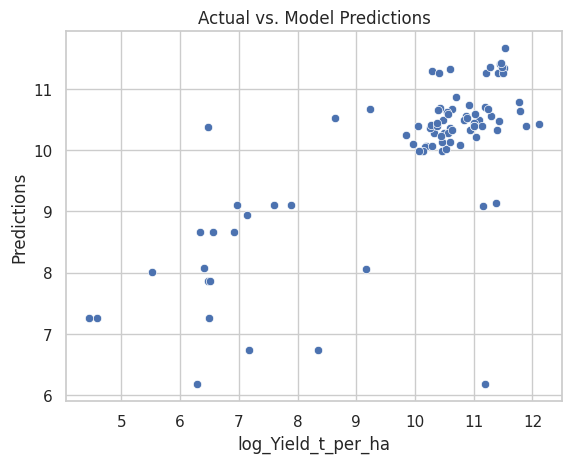

In [ ]:
# Make predictions on the test data
y_pred = lm.predict(X_test)

# Scatter plot of actual values of y vs predicted values.
sns.scatterplot(x=y_test, y=y_pred)
plt.ylabel('Predictions')
plt.title('Actual vs. Model Predictions')
plt.show()

# Evaluation of the model

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error
import math

In [ ]:
print('Mean Absolute Error:',mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:',mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:',math.sqrt(mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 0.8095035527742741
Mean Squared Error: 1.4851469896478455
Root Mean Squared Error: 1.2186660697860778


# Residuals

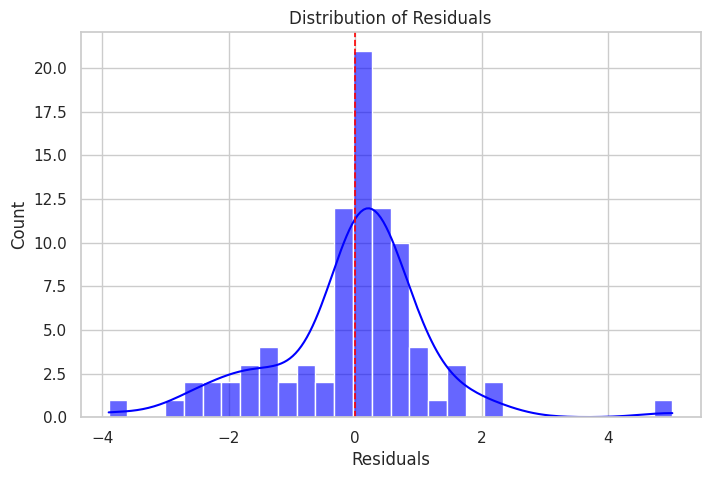

In [ ]:
# Compute residuals
residuals = y_test - y_pred

# Plot histogram with KDE
plt.figure(figsize=(8,5))
sns.histplot(residuals, bins=30, kde=True, color="blue", alpha=0.6)
plt.axvline(0, color="red", linestyle="--", linewidth=1.2)
plt.xlabel("Residuals")
plt.title("Distribution of Residuals")
plt.show()


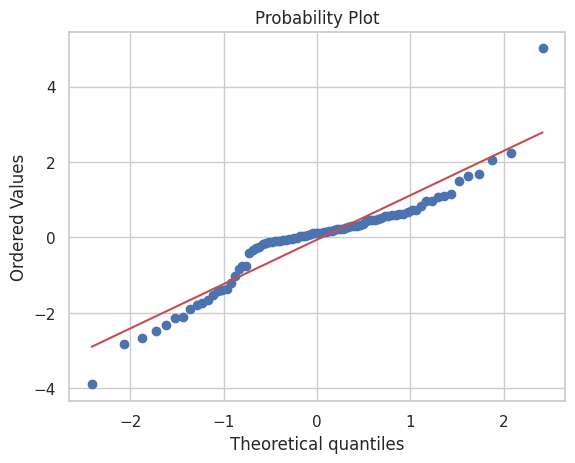

In [ ]:
import pylab
import scipy.stats as stats

stats.probplot(residuals, dist="norm", plot=pylab)
pylab.show()

# 8. Conclusion
Regression modeling was employed to Predict maize yield per hectare and investigated agricultural productivity drivers. Preparation of data and feature engineering enabled us to develop target variables and indicators such as growth rates and yield anomalies. We trained Scikit-Learn's Linear Regression and Statsmodels OLS models, and measures of model fit (MAE, MSE, RMSE) reflected good accuracy in prediction. The study highlighted dominant features in yield variation and points out areas of improvement. Future research can delve into sophisticated machine learning models, regularization in cases of multicollinearity, and inclusion of outside data such as weather and soil information. Generally, the study demonstrates regression models can provide useful information in terms of agricultural yield prediction and provide a foundation upon which better forecasting schemes can be developed.